In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
import cv2
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.preprocessing import MinMaxScaler

In [ ]:
feature_data = pd.read_excel('/content/drive/MyDrive/Pistachio_Image_Dataset/Pistachio_28_Features_Dataset/Pistachio_28_Features_Dataset.xlsx')

In [ ]:
print("First few rows of the feature dataset:")
print(feature_data.head(10))

print("\nMissing values in the feature dataset:")
print(feature_data.isnull().sum())

print("\nSummary statistics of numerical features:")
print(feature_data.describe())

First few rows of the feature dataset:
    Area  Perimeter  Major_Axis  Minor_Axis  Eccentricity   Eqdiasq  Solidity  \
0  63391   1568.405    390.3396    236.7461        0.7951  284.0984    0.8665   
1  68358   1942.187    410.8594    234.7525        0.8207  295.0188    0.8765   
2  73589   1246.538    452.3630    220.5547        0.8731  306.0987    0.9172   
3  71106   1445.261    429.5291    216.0765        0.8643  300.8903    0.9589   
4  80087   1251.524    469.3783    220.9344        0.8823  319.3273    0.9657   
5  52268   1154.150    383.8558    197.5020        0.8575  257.9723    0.8563   
6  71693   1463.932    388.2366    252.8200        0.7589  302.1297    0.9156   
7  62240   1898.450    385.7238    218.1349        0.8247  281.5074    0.8947   
8  64319   2011.291    435.9127    213.7594        0.8715  286.1704    0.8633   
9  78115   1238.623    492.3300    204.9987        0.9092  315.3714    0.9616   

   Convex_Area  Extent  Aspect_Ratio  ...  StdDev_RR  StdDev_RG  StdD

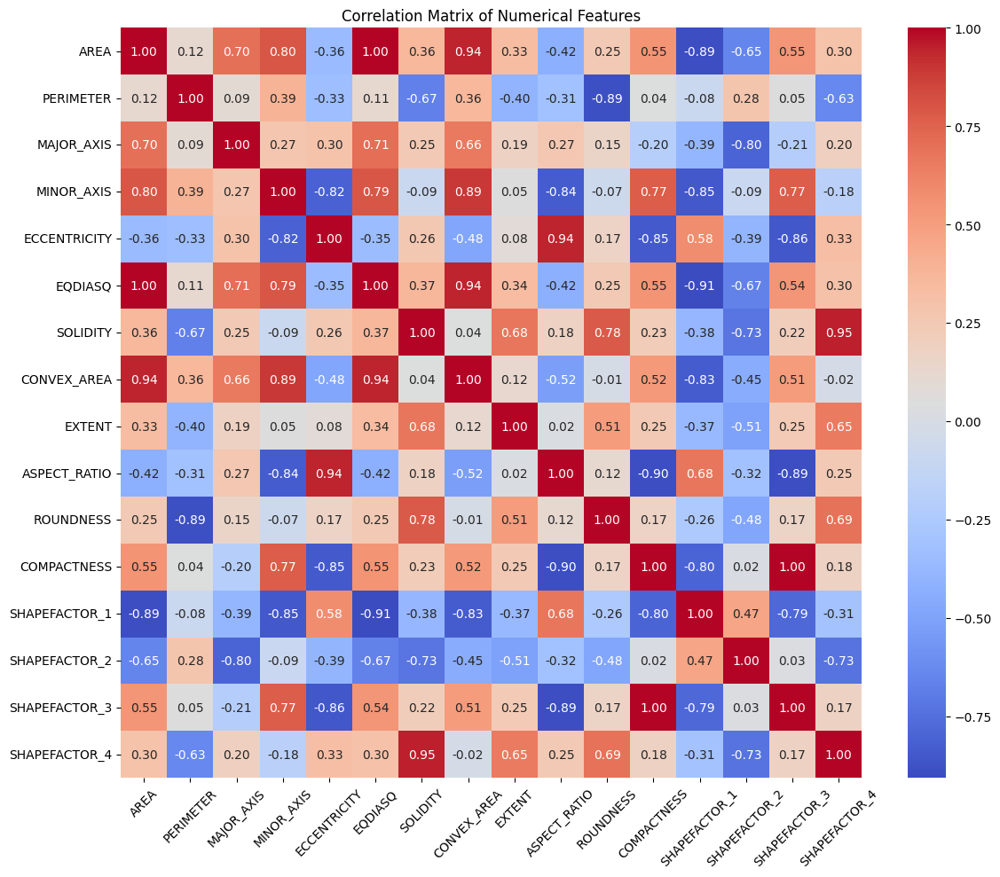

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Load the feature dataset
feature_data = pd.read_excel('/content/drive/MyDrive/Pistachio_Image_Dataset/Pistachio_16_Features_Dataset/Pistachio_16_Features_Dataset.xlsx')

# Extract numerical features
numerical_features = feature_data.select_dtypes(include=['number'])

# Calculate the correlation matrix
corr_matrix = numerical_features.corr()

# Plotting the correlation matrix as a heatmap
plt.figure(figsize=(12, 10))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Matrix of Numerical Features')
plt.xticks(rotation=45)
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()

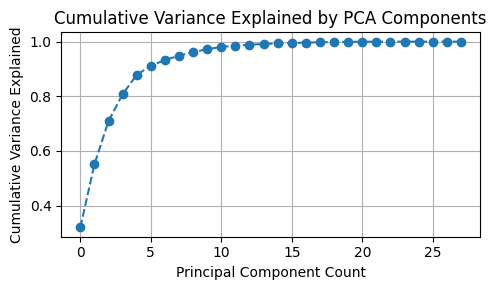

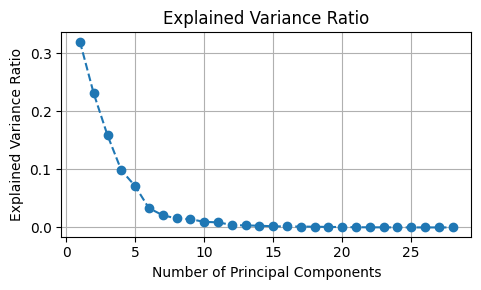

Optimal number of components for 95% variance: 9
   Component  Importance
0          1    0.332337
1          2    0.239627
2          3    0.164727
3          4    0.102155
4          5    0.074009
5          6    0.034440
6          7    0.021853
7          8    0.016061
8          9    0.014790


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from sklearn.decomposition import PCA

# Load the dataset
data_path = '/content/drive/MyDrive/Pistachio_Image_Dataset/Pistachio_28_Features_Dataset/Pistachio_28_Features_Dataset.xlsx'
pistachio_dataset = pd.read_excel(data_path)

# Isolate the numeric columns for analysis
numeric_data = pistachio_dataset.select_dtypes(include=[np.number])

# Check and handle missing values in the numeric columns
if numeric_data.isnull().any().any():
    numeric_data = numeric_data.fillna(numeric_data.mean())

# Normalize the numeric data
normalizer = MinMaxScaler()
normalized_numeric_data = normalizer.fit_transform(numeric_data)

# Initialize and apply PCA
pca_processor = PCA()
pca_result = pca_processor.fit_transform(normalized_numeric_data)

# Calculate the explained variance
variance_explained = pca_processor.explained_variance_ratio_
cumulative_variance = np.cumsum(variance_explained)

# Plot the cumulative explained variance to determine the number of components
plt.figure(figsize=(5, 3))
plt.plot(cumulative_variance, marker='o', linestyle='--')
plt.title('Cumulative Variance Explained by PCA Components')
plt.xlabel('Principal Component Count')
plt.ylabel('Cumulative Variance Explained')
plt.grid(True)
plt.tight_layout()  # Adjust layout to make room
plt.show()

# Add some space (just for visual separation in the code, not affecting the plot)
print("\n" * 2)  # Print newlines to add space in the notebook output

# Plot the elbow plot to select the optimal number of principal components
plt.figure(figsize=(5, 3))
plt.plot(range(1, len(variance_explained) + 1), variance_explained, marker='o', linestyle='--')
plt.title('Explained Variance Ratio')
plt.xlabel('Number of Principal Components')
plt.ylabel('Explained Variance Ratio')
plt.grid(True)
plt.tight_layout()  # Adjust layout to make room
plt.show()

# Identify the number of components for 95% variance
component_count = np.where(cumulative_variance >= 0.95)[0][0] + 1
print(f"Optimal number of components for 95% variance: {component_count}")

# Apply PCA with the determined optimal number of components
optimal_pca = PCA(n_components=component_count)
optimal_components = optimal_pca.fit_transform(normalized_numeric_data)

# Determine the importance of each principal component
component_variance = np.var(optimal_components, axis=0)
component_importance = component_variance / np.sum(component_variance)

# Construct a DataFrame to show the importance of each principal component
component_importance_df = pd.DataFrame({'Component': np.arange(1, component_count + 1),
                                        'Importance': component_importance})

print(component_importance_df)

Load your dataset

In [ ]:
data_path = '/content/drive/MyDrive/Pistachio_Image_Dataset/Pistachio_28_Features_Dataset/Pistachio_28_Features_Dataset.xlsx'
pistachio_data = pd.read_excel(data_path)

Separate numerical and non-numeric columns¶

In [ ]:
numeric_cols = pistachio_data._get_numeric_data().columns
categorical_cols = pistachio_data.select_dtypes(include=['object', 'category']).columns

Normalize the numerical columns of the dataset

In [ ]:
min_max_scaler = MinMaxScaler()
scaled_numeric_data = min_max_scaler.fit_transform(pistachio_data[numeric_cols])

Combine normalized numerical data with non-numeric columns

In [ ]:
min_max_scaler = MinMaxScaler()
scaled_numeric_data = min_max_scaler.fit_transform(pistachio_data[numeric_cols])

Standardize the dataset

In [ ]:
from sklearn.preprocessing import StandardScaler

# Assuming pistachio_data is your dataset and numeric_cols is a list of numeric column names
standardizer = StandardScaler()
standardized_numeric_data = standardizer.fit_transform(pistachio_data[numeric_cols])

Perform PCA on the standardized dataset

In [ ]:
pca_model = PCA(n_components=5)
pca_results = pca_model.fit_transform(standardized_numeric_data)

Perform LDA on the standardized dataset

In [ ]:
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis

# Apply LDA

class_col = 'Class'  # Assuming 'Class' is the target column
unique_classes = pistachio_data[class_col].nunique()
lda_components = min(unique_classes - 1, len(numeric_cols))
lda_model = LinearDiscriminantAnalysis(n_components=lda_components)
lda_results = lda_model.fit_transform(standardized_numeric_data, pistachio_data[class_col])

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Save all datasets

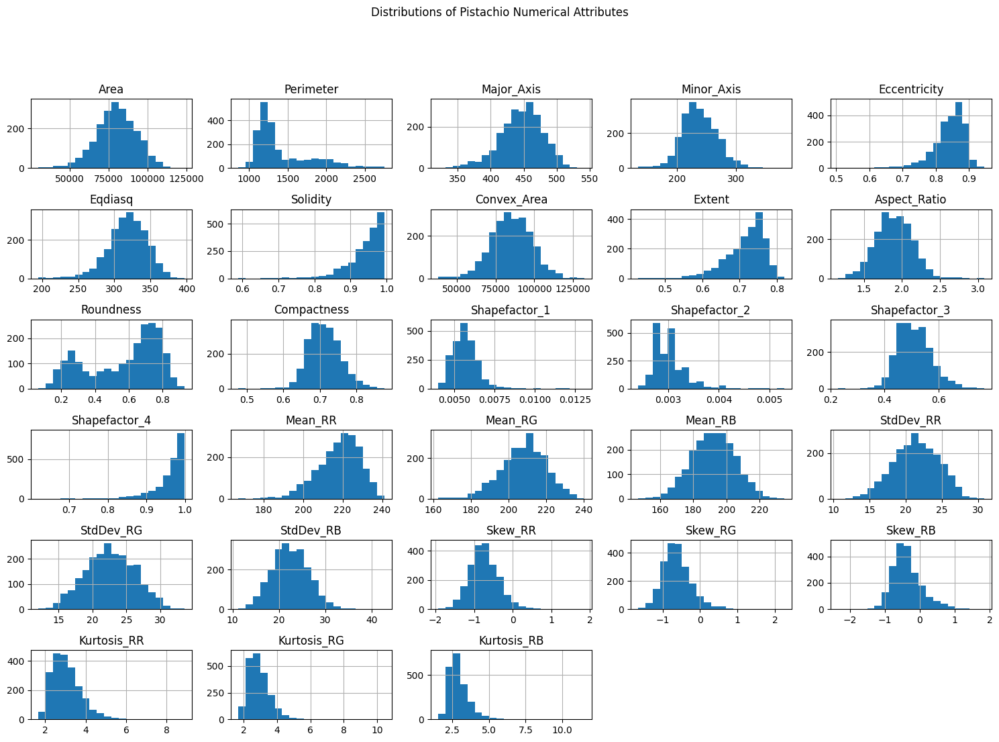

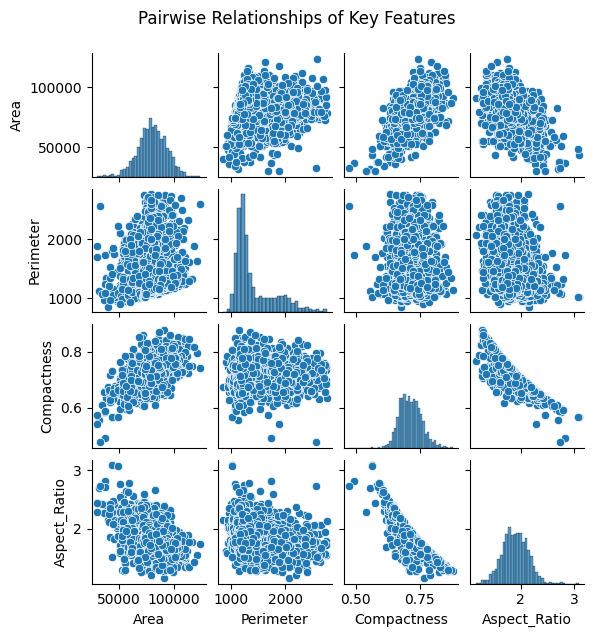

In [ ]:
# Define the directory path for saving the processed files
output_dir = '/content/drive/MyDrive/Pistachio_Image_Dataset'

# Create the directory if it doesn't exist
os.makedirs(output_dir, exist_ok=True)

# Assume numeric_cols and categorical_cols are already defined and hold the correct column names
scaled_numeric_data = min_max_scaler.fit_transform(pistachio_data[numeric_cols])
scaled_data = pd.DataFrame(scaled_numeric_data, columns=numeric_cols)

# Concatenate the scaled numeric data with the categorical columns to form final_data
final_data = pd.concat([scaled_data, pistachio_data[categorical_cols]], axis=1)

pistachio_data.to_csv(f'{output_dir}/original_dataset.csv', index=False)
final_data.to_csv(f'{output_dir}/scaled_dataset.csv', index=False)
pd.DataFrame(standardized_numeric_data, columns=numeric_cols).to_csv(f'{output_dir}/standardized_dataset.csv', index=False)
pd.DataFrame(pca_results, columns=[f'PCA_{i+1}' for i in range(pca_results.shape[1])]).to_csv(f'{output_dir}/pca_results.csv', index=False)

final_data.to_csv(f'{output_dir}/scaled_dataset.csv', index=False)

# Check LDA output dimensions and save

lda_columns = [f'LDA_{i+1}' for i in range(lda_results.shape[1])]
pd.DataFrame(lda_results, columns=lda_columns).to_csv(f'{output_dir}/lda_results.csv', index=False)

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import warnings

# Ignore specific FutureWarnings from Seaborn or other libraries
warnings.filterwarnings("ignore", category=FutureWarning)

# Load dataset from the specified path
data_path = '/content/drive/MyDrive/Pistachio_Image_Dataset/Pistachio_28_Features_Dataset/Pistachio_28_Features_Dataset.xlsx'
pistachio_data = pd.read_excel(data_path)

# Generate histograms for all numeric attributes in the dataset
numeric_attrs = pistachio_data.select_dtypes(include=[np.number]).columns
pistachio_data[numeric_attrs].hist(figsize=(15, 10), bins=20)
# Adjust spacing and layout
plt.tight_layout()
plt.suptitle('Distributions of Pistachio Numerical Attributes', y=1.10)  # Adjust y to avoid overlap with title
plt.show()

# Visualize pairwise relationships in the dataset for a subset of features
features_to_plot = ['Area', 'Perimeter', 'Compactness', 'Aspect_Ratio']
pairplot_figure = sns.pairplot(pistachio_data[features_to_plot], height=1.5)  # Change the height value as needed
pairplot_figure.fig.suptitle('Pairwise Relationships of Key Features', y=1.05)  # Adjust title position
plt.show()

In [ ]:
import os
from PIL import Image

# Function to load images from a folder
def load_images_from_folder(folder):
    images = []
    for filename in os.listdir(folder):
        img_path = os.path.join(folder, filename)
        try:
            img = Image.open(img_path)
            images.append(img)
        except IOError:
            pass  # Skip if the file cannot be opened as an image
    return images

# Load images from the first folder
kirmizi_images = load_images_from_folder('/content/drive/MyDrive/Pistachio_Image_Dataset/Pistachio_Image_Dataset/Kirmizi_Pistachio')

# Load images from the second folder
siirt_images = load_images_from_folder('/content/drive/MyDrive/Pistachio_Image_Dataset/Pistachio_Image_Dataset/Siirt_Pistachio')

# Display the number of images loaded from each folder
print("Number of Kirmizi Pistachio images found:", len(kirmizi_images))
print("Number of Siirt Pistachio images found:", len(siirt_images))

Number of Kirmizi Pistachio images found: 1232
Number of Siirt Pistachio images found: 916


Displaying images from /content/drive/MyDrive/Pistachio_Image_Dataset/Pistachio_Image_Dataset/Kirmizi_Pistachio


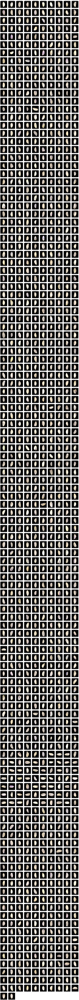

Displaying images from /content/drive/MyDrive/Pistachio_Image_Dataset/Pistachio_Image_Dataset/Siirt_Pistachio


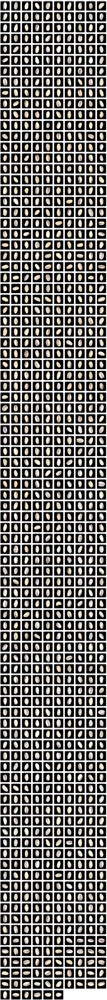

In [ ]:
import os
import cv2
import matplotlib.pyplot as plt

# Directories containing the images
directories = [
    "/content/drive/MyDrive/Pistachio_Image_Dataset/Pistachio_Image_Dataset/Kirmizi_Pistachio",
    "/content/drive/MyDrive/Pistachio_Image_Dataset/Pistachio_Image_Dataset/Siirt_Pistachio"
]

# Define the size of the images and the number of columns in the grid
image_size = (2, 2)  # Smaller size
columns = 10  # Increase columns to reduce overall height

for directory in directories:
    # List all files in the directory
    image_files = [f for f in os.listdir(directory) if os.path.isfile(os.path.join(directory, f))]

    print(f"Displaying images from {directory}")

    # Calculate the number of rows needed in the grid, adjust for large numbers of images
    rows = (len(image_files) + columns - 1) // columns  # Ensure complete rows

    # Create a figure with subplots
    fig, axes = plt.subplots(rows, columns, figsize=(columns * image_size[0], rows * image_size[1]))

    # Flatten axes array for easy indexing
    axes = axes.flatten()

    for index, image_file in enumerate(image_files):
        # Construct the full path to the image
        image_path = os.path.join(directory, image_file)

        # Load the image
        img = cv2.imread(image_path)

        # Check if image is loaded successfully
        if img is None:
            print(f"Failed to load image from: {image_path}")
            continue

        # Display the color image
        ax = axes[index]
        ax.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        ax.axis('off')
        ax.set_title(f'Image: {image_file}', fontsize=8)

    # Hide unused axes if any
    for ax in axes[len(image_files):]:
        ax.axis('off')

    plt.tight_layout()
    plt.show()

In [29]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import accuracy_score

# Load your feature dataset if not already loaded
feature_data = pd.read_excel('/content/drive/MyDrive/Pistachio_Image_Dataset/Pistachio_28_Features_Dataset/Pistachio_28_Features_Dataset.xlsx')

# Assuming 'X' contains features and 'y' contains labels
X = feature_data.drop(columns=['Class'])
y = feature_data['Class']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Standardize the features (optional but recommended for some algorithms like kNN and SVM)
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Initialize classification models
knn = KNeighborsClassifier()
dt = DecisionTreeClassifier()
rf = RandomForestClassifier()
nb = GaussianNB()
svm = SVC()
mlp = MLPClassifier()

# Train the models
knn.fit(X_train_scaled, y_train)
dt.fit(X_train, y_train)
rf.fit(X_train, y_train)
nb.fit(X_train, y_train)
svm.fit(X_train_scaled, y_train)
mlp.fit(X_train_scaled, y_train)

# Predict using the trained models
y_pred_knn = knn.predict(X_test_scaled)
y_pred_dt = dt.predict(X_test)
y_pred_rf = rf.predict(X_test)
y_pred_nb = nb.predict(X_test)
y_pred_svm = svm.predict(X_test_scaled)
y_pred_mlp = mlp.predict(X_test_scaled)

# Evaluate the models
accuracy_knn = accuracy_score(y_test, y_pred_knn)
accuracy_dt = accuracy_score(y_test, y_pred_dt)
accuracy_rf = accuracy_score(y_test, y_pred_rf)
accuracy_nb = accuracy_score(y_test, y_pred_nb)
accuracy_svm = accuracy_score(y_test, y_pred_svm)
accuracy_mlp = accuracy_score(y_test, y_pred_mlp)

# Display the accuracy of each model
print("Accuracy of Model 1:", accuracy_knn)
print("Accuracy of Model 2:", accuracy_dt)
print("Accuracy of Model 3:", accuracy_rf)
print("Accuracy of Model 4:", accuracy_nb)
print("Accuracy of Model 5:", accuracy_svm)
print("Accuracy of Model 6:", accuracy_mlp)


/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


Accuracy of Model 1: 0.8976744186046511
Accuracy of Model 2: 0.8395348837209302
Accuracy of Model 3: 0.9116279069767442
Accuracy of Model 4: 0.8116279069767441
Accuracy of Model 5: 0.9465116279069767
Accuracy of Model 6: 0.9511627906976744


In [31]:
import os
import cv2
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense
from tensorflow.keras.utils import to_categorical

# Function to load and preprocess images from a directory
def load_images_from_dir(directory, label):
    images = []
    labels = []
    for filename in os.listdir(directory):
        if filename.endswith(".jpg"):
            img = cv2.imread(os.path.join(directory, filename))
            img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)  # Convert to grayscale
            img = cv2.resize(img, (100, 100))  # Resize images
            images.append(img)
            labels.append(label)
    return images, labels

# Load images from the dataset directories
folder1_images, folder1_labels = load_images_from_dir("/content/drive/MyDrive/Pistachio_Image_Dataset/Pistachio_Image_Dataset/Kirmizi_Pistachio", label=0)
folder2_images, folder2_labels = load_images_from_dir("/content/drive/MyDrive/Pistachio_Image_Dataset/Pistachio_Image_Dataset/Siirt_Pistachio", label=1)

# Concatenate images and labels
X = np.array(folder1_images + folder2_images)
y = np.array(folder1_labels + folder2_labels)

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Flatten the images for Naïve Bayes and SVM
X_train_flat = X_train.reshape(X_train.shape[0], -1)
X_test_flat = X_test.reshape(X_test.shape[0], -1)

# Normalize pixel values
X_train_flat = X_train_flat.astype('float32') / 255.0
X_test_flat = X_test_flat.astype('float32') / 255.0

# Train and evaluate Naïve Bayes classifier
nb_classifier = GaussianNB()
nb_classifier.fit(X_train_flat, y_train)
nb_pred = nb_classifier.predict(X_test_flat)
nb_accuracy = accuracy_score(y_test, nb_pred)
print("Model 1 NB Accuracy:", nb_accuracy)

# Train and evaluate SVM classifier
svm_classifier = SVC(kernel='linear')
svm_classifier.fit(X_train_flat, y_train)
svm_pred = svm_classifier.predict(X_test_flat)
svm_accuracy = accuracy_score(y_test, svm_pred)
print("Model 2 SVM Accuracy:", svm_accuracy)

# Reshape images for MLP and CNN
X_train_reshaped = X_train.reshape(X_train.shape[0], 100, 100, 1)
X_test_reshaped = X_test.reshape(X_test.shape[0], 100, 100, 1)

# Convert labels for MLP and CNN
y_train_encoded = to_categorical(y_train)
y_test_encoded = to_categorical(y_test)

# Train and evaluate MLP classifier
mlp_classifier = MLPClassifier(hidden_layer_sizes=(100,), max_iter=1000)
mlp_classifier.fit(X_train_flat, y_train)
mlp_pred = mlp_classifier.predict(X_test_flat)
mlp_accuracy = accuracy_score(y_test, mlp_pred)
print("Model 3 MLP Accuracy:", mlp_accuracy)

# Define CNN architecture
cnn_model = Sequential([
    Conv2D(32, (3, 3), activation='relu', input_shape=(100, 100, 1)),
    MaxPooling2D((2, 2)),
    Conv2D(64, (3, 3), activation='relu'),
    MaxPooling2D((2, 2)),
    Flatten(),
    Dense(64, activation='relu'),
    Dense(2, activation='softmax')
])

# Compile and train the CNN model
cnn_model.compile(optimizer='adam',
                  loss='categorical_crossentropy',
                  metrics=['accuracy'])
cnn_model.fit(X_train_reshaped, y_train_encoded, epochs=10, batch_size=32, validation_split=0.2)

# Evaluate the CNN model
cnn_loss, cnn_accuracy = cnn_model.evaluate(X_test_reshaped, y_test_encoded)
print("Model 4 CNN Accuracy:", cnn_accuracy)

Model 1 NB Accuracy: 0.713953488372093
Model 2 SVM Accuracy: 0.8534883720930233
Model 3 MLP Accuracy: 0.8558139534883721
Epoch 1/10
43/43 [==============================] - 20s 440ms/step - loss: 14.5198 - accuracy: 0.6907 - val_loss: 0.4304 - val_accuracy: 0.7965
Epoch 2/10
43/43 [==============================] - 25s 584ms/step - loss: 0.3491 - accuracy: 0.8479 - val_loss: 0.3835 - val_accuracy: 0.8169
Epoch 3/10
43/43 [==============================] - 19s 455ms/step - loss: 0.2808 - accuracy: 0.8770 - val_loss: 0.4373 - val_accuracy: 0.8052
Epoch 4/10
43/43 [==============================] - 24s 549ms/step - loss: 0.2465 - accuracy: 0.8908 - val_loss: 0.3683 - val_accuracy: 0.8488
Epoch 5/10
43/43 [==============================] - 20s 472ms/step - loss: 0.1807 - accuracy: 0.9265 - val_loss: 0.3303 - val_accuracy: 0.8547
Epoch 6/10
43/43 [==============================] - 21s 475ms/step - loss: 0.1384 - accuracy: 0.9440 - val_loss: 0.3932 - val_accuracy: 0.8401
Epoch 7/10
43/43 [==

In [32]:
def print_class_accuracy(y_test, predictions, model_name, class_labels):
    for label in class_labels:
        class_accuracy = accuracy_score(y_test[y_test == label], predictions[y_test == label])
        print(f"{model_name} Accuracy on {class_labels[label]} dataset:", class_accuracy)

class_labels = {0: "Kirmizi", 1: "Siirt"}

# Calculate and print accuracy for Naïve Bayes
print_class_accuracy(y_test, nb_pred, "Naïve Bayes", class_labels)

# Calculate and print accuracy for SVM
print_class_accuracy(y_test, svm_pred, "SVM", class_labels)

# Calculate and print accuracy for MLP
print_class_accuracy(y_test, mlp_pred, "MLP", class_labels)

# For CNN, handling the reshaped test set and encoded labels
def print_cnn_accuracy(model, X_test_reshaped, y_test, y_test_encoded, class_labels):
    for label in class_labels:
        class_accuracy = model.evaluate(X_test_reshaped[y_test == label], y_test_encoded[y_test == label], verbose=0)[1]
        print(f"CNN Accuracy on {class_labels[label]} dataset:", class_accuracy)

# Calculate and print accuracy for CNN
print_cnn_accuracy(cnn_model, X_test_reshaped, y_test, y_test_encoded, class_labels)

Naïve Bayes Accuracy on Kirmizi dataset: 0.9549180327868853
Naïve Bayes Accuracy on Siirt dataset: 0.3978494623655914
SVM Accuracy on Kirmizi dataset: 0.8360655737704918
SVM Accuracy on Siirt dataset: 0.8763440860215054
MLP Accuracy on Kirmizi dataset: 0.8811475409836066
MLP Accuracy on Siirt dataset: 0.8225806451612904
CNN Accuracy on Kirmizi dataset: 0.8729507923126221
CNN Accuracy on Siirt dataset: 0.9032257795333862


In [33]:
import os
import cv2
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, classification_report
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense
from tensorflow.keras.utils import to_categorical

def load_images_from_dir(directory, label):
    images, labels = [], []
    for filename in os.listdir(directory):
        if filename.endswith(".jpg"):
            img_path = os.path.join(directory, filename)
            img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
            img = cv2.resize(img, (100, 100))
            images.append(img)
            labels.append(label)
    return np.array(images), np.array(labels)

def train_evaluate_classifier(clf, X_train, y_train, X_test, y_test, classifier_name):
    clf.fit(X_train, y_train)
    predictions = clf.predict(X_test)
    accuracy = accuracy_score(y_test, predictions)
    precision = precision_score(y_test, predictions)
    recall = recall_score(y_test, predictions)
    f1 = f1_score(y_test, predictions)

    print(f"{classifier_name} Metrics:")
    print("Accuracy:", accuracy)
    print("Precision:", precision)
    print("Recall:", recall)
    print("F1-score:", f1)
    print(classification_report(y_test, predictions))

def train_evaluate_cnn(model, X_train, y_train, X_test, y_test):
    model.fit(X_train, y_train, epochs=20, batch_size=32, validation_split=0.2)
    loss, accuracy = model.evaluate(X_test, y_test)
    print("CNN Accuracy:", accuracy)

# Load images and labels
kirmizi_images, kirmizi_labels = load_images_from_dir("/content/drive/MyDrive/Pistachio_Image_Dataset/Pistachio_Image_Dataset/Kirmizi_Pistachio", label=0)
siirt_images, siirt_labels = load_images_from_dir("/content/drive/MyDrive/Pistachio_Image_Dataset/Pistachio_Image_Dataset/Siirt_Pistachio", label=1)

X = np.concatenate((kirmizi_images, siirt_images), axis=0)
y = np.concatenate((kirmizi_labels, siirt_labels), axis=0)

# Split dataset
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Preprocess for traditional classifiers
X_train_flat = X_train.reshape(X_train.shape[0], -1) / 255.0
X_test_flat = X_test.reshape(X_test.shape[0], -1) / 255.0

# Train and evaluate traditional classifiers
train_evaluate_classifier(GaussianNB(), X_train_flat, y_train, X_test_flat, y_test, "Naïve Bayes")
train_evaluate_classifier(SVC(kernel='linear'), X_train_flat, y_train, X_test_flat, y_test, "SVM")
train_evaluate_classifier(MLPClassifier(hidden_layer_sizes=(100,), max_iter=1000), X_train_flat, y_train, X_test_flat, y_test, "MLP")

# Preprocess for CNN
X_train_reshaped = X_train.reshape(X_train.shape[0], 100, 100, 1) / 255.0
X_test_reshaped = X_test.reshape(X_test.shape[0], 100, 100, 1) / 255.0
y_train_encoded = to_categorical(y_train)
y_test_encoded = to_categorical(y_test)

# Define, compile, and train CNN
cnn_model = Sequential([
    Conv2D(32, (3, 3), activation='relu', input_shape=(100, 100, 1)),
    MaxPooling2D((2, 2)),
    Conv2D(64, (3, 3), activation='relu'),
    MaxPooling2D((2, 2)),
    Flatten(),
    Dense(64, activation='relu'),
    Dense(2, activation='softmax')
])
cnn_model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
train_evaluate_cnn(cnn_model, X_train_reshaped, y_train_encoded, X_test_reshaped, y_test_encoded)


Naïve Bayes Metrics:
Accuracy: 0.7255813953488373
Precision: 0.8617021276595744
Recall: 0.43548387096774194
F1-score: 0.5785714285714285
              precision    recall  f1-score   support

           0       0.69      0.95      0.80       244
           1       0.86      0.44      0.58       186

    accuracy                           0.73       430
   macro avg       0.77      0.69      0.69       430
weighted avg       0.76      0.73      0.70       430

SVM Metrics:
Accuracy: 0.8534883720930233
Precision: 0.8029556650246306
Recall: 0.8763440860215054
F1-score: 0.8380462724935733
              precision    recall  f1-score   support

           0       0.90      0.84      0.87       244
           1       0.80      0.88      0.84       186

    accuracy                           0.85       430
   macro avg       0.85      0.86      0.85       430
weighted avg       0.86      0.85      0.85       430

MLP Metrics:
Accuracy: 0.8465116279069768
Precision: 0.8
Recall: 0.86021505376344

In [34]:
from sklearn.metrics import classification_report
import numpy as np

def evaluate_cnn_model(model, X_test_reshaped, y_test_encoded):
    # Predict labels using the CNN model
    cnn_pred = np.argmax(model.predict(X_test_reshaped), axis=-1)

    # Convert one-hot encoded labels to integers for classification_report
    y_test_int = np.argmax(y_test_encoded, axis=1)

    # Generate and print the classification report for the CNN model
    cnn_report = classification_report(y_test_int, cnn_pred)
    print("CNN Metrics:")
    print(cnn_report)

# Use the function to evaluate the CNN model
evaluate_cnn_model(cnn_model, X_test_reshaped, y_test_encoded)

14/14 [==============================] - 2s 160ms/step
CNN Metrics:
              precision    recall  f1-score   support

           0       0.92      0.89      0.90       244
           1       0.86      0.90      0.88       186

    accuracy                           0.89       430
   macro avg       0.89      0.89      0.89       430
weighted avg       0.89      0.89      0.89       430



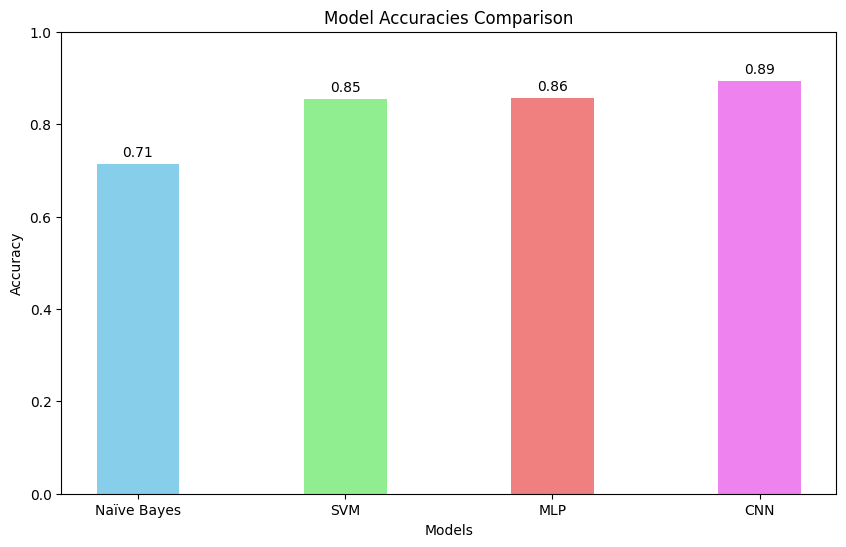

In [38]:
import matplotlib.pyplot as plt

# Assuming accuracy scores are already calculated
nb_accuracy = accuracy_score(y_test, nb_pred)
svm_accuracy = accuracy_score(y_test, svm_pred)
mlp_accuracy = accuracy_score(y_test, mlp_pred)
cnn_accuracy = cnn_model.evaluate(X_test_reshaped, y_test_encoded, verbose=0)[1]

# Store accuracies in a dictionary
accuracies = {
    'Naïve Bayes': nb_accuracy,
    'SVM': svm_accuracy,
    'MLP': mlp_accuracy,
    'CNN': cnn_accuracy
}

# Define colors for each bar
colors = ['skyblue', 'lightgreen', 'lightcoral', 'violet']

# Plot the accuracies in a bar chart with thinner bars and playful colors
plt.figure(figsize=(10, 6))
bars = plt.bar(accuracies.keys(), accuracies.values(), color=colors, width=0.4)  # Adjust the width here
plt.xlabel('Models')
plt.ylabel('Accuracy')
plt.title('Model Accuracies Comparison')
plt.ylim([0, 1])  # Assuming accuracy is between 0 and 1

# Annotate bars with the accuracy values
for bar in bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval + 0.01, f'{yval:.2f}', ha='center', va='bottom')

plt.show()


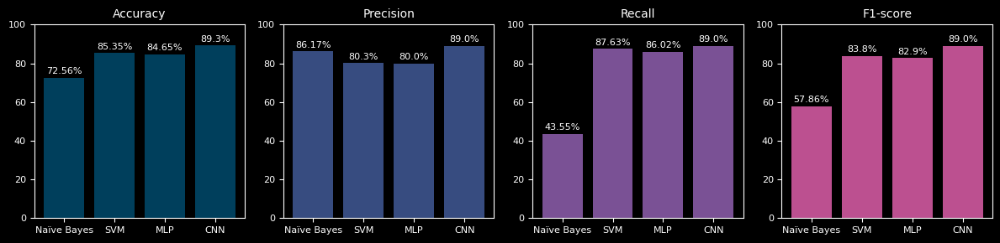

In [5]:
import matplotlib.pyplot as plt
import numpy as np

# Model names and metrics
models = ['Naïve Bayes', 'SVM', 'MLP', 'CNN']
accuracy = [72.56, 85.35, 84.65, 89.30]
precision = [86.17, 80.30, 80.00, 89.00]
recall = [43.55, 87.63, 86.02, 89.00]
f1_score = [57.86, 83.80, 82.90, 89.00]
metrics = [accuracy, precision, recall, f1_score]
metric_names = ['Accuracy', 'Precision', 'Recall', 'F1-score']
colors = ['#003f5c', '#374c80', '#7a5195', '#bc5090']

# Create subplots: 1 row, 4 columns
fig, axes = plt.subplots(1, 4, figsize=(12, 3))  # Increase the figure size if needed

# Loop through metrics
for i, ax in enumerate(axes):
    ax.bar(models, metrics[i], color=colors[i])
    ax.set_title(metric_names[i], fontsize=10, color='white')
    ax.set_ylim(0, 100)
    ax.tick_params(axis='x', labelsize=8)
    ax.tick_params(axis='y', labelsize=8)

    # Annotate bars with the percentage values
    for j in range(len(models)):
        ax.text(j, metrics[i][j] + 1, f'{metrics[i][j]}%', ha='center', va='bottom', fontsize=8, color='white')

plt.tight_layout()
plt.show()